# DSMCER Lecture 1 - Intro to Data Visualization

__Table of Contents__:
1. Why Visualize?
    1. Types of data
    2. Choices of encoding
2. Basic visualization in Python
    1. Matplotlib: the most simple
    2. Basic plot attributes
    3. _Exercise_: Create a plot from scratch
    4. Subplots
3. Expressiveness and Effectiveness at a glance
    1. The EE balance
    2. _Poll_: rate some plots
4. Back to the Python
    1. Pandas
    2. Plot type zoo
    3. _Exercise_: create a visual communication to explore a question
    4. Seaborn and more plots
    
***
***

## 1. Why Visualize?

<center>
    <font size=5>
        <span style="color:blue">QUICK</span> - what is the relationship between VOC and Jsc?
    </font>
</center>


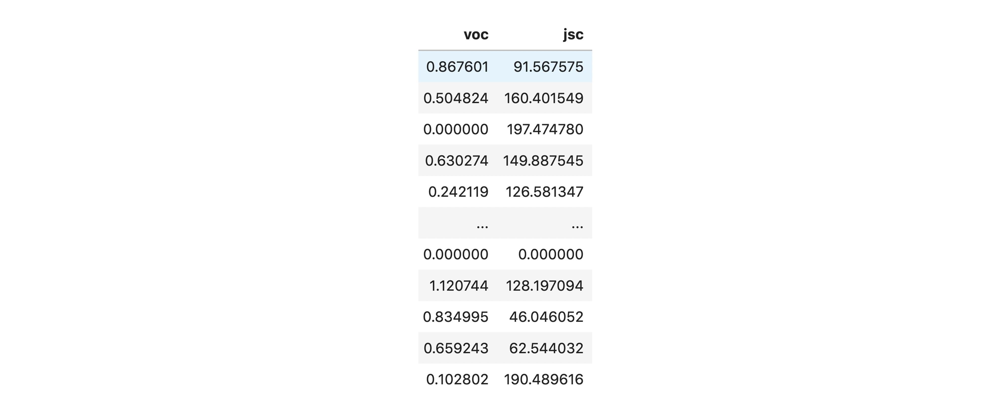

<center>
    <font size=4>
        A bunch of numbers are not attention grabbing, easy to interpret, or inciting of further thought...
    </font>
</center>

***

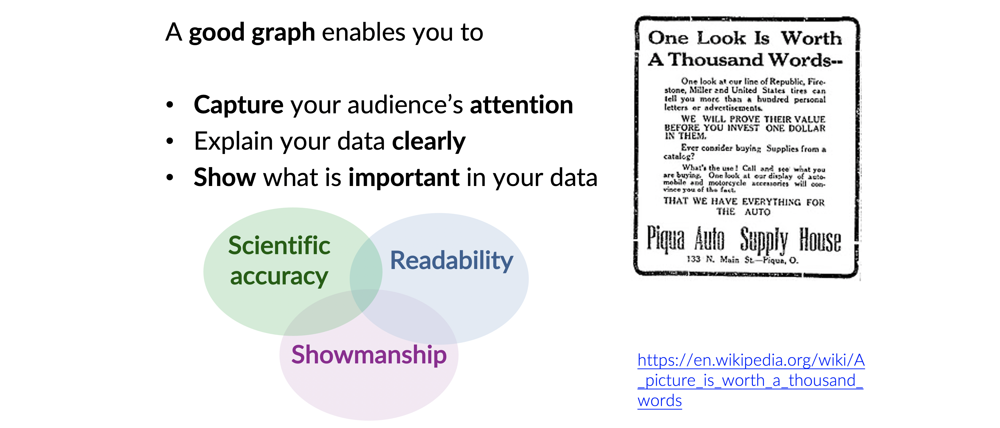
***

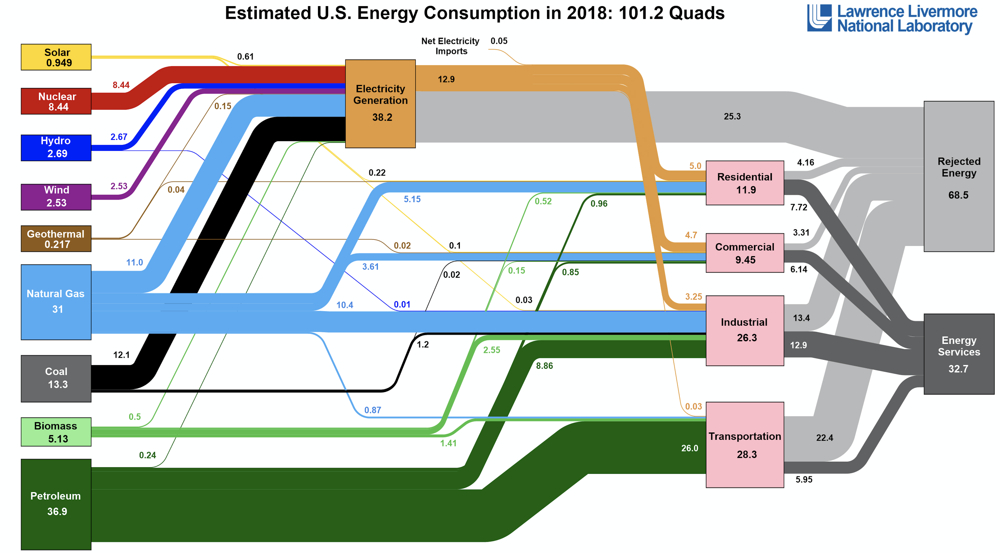

<center>
    <font size=5>
        What message do you get from the plot? What choices were made than enhance the message?
    </font>
</center>


> Energy comes from many different sources. The majority is from non-renewables. The majority is wasted. What we do use is mostly used by Transportation and Industry

> Colors were used to distiguish energy sources and sinks. Box and mand sizes were used to encode quantity.

***

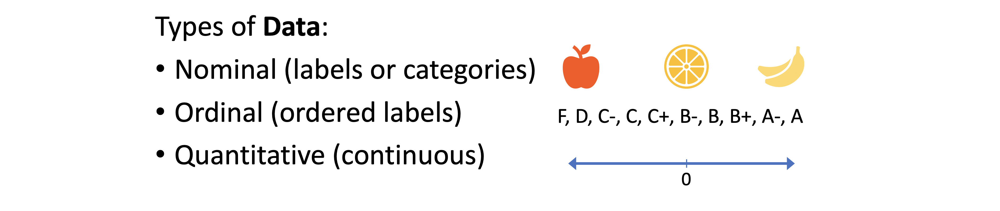

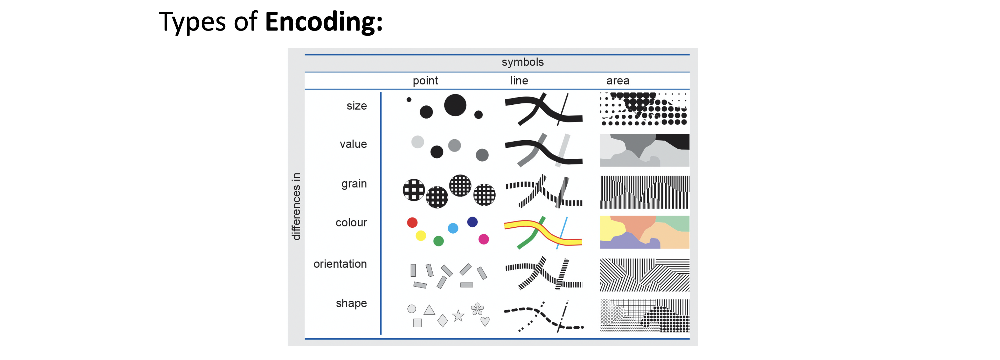

https://ltb.itc.utwente.nl/509/concept/88863

***

## 2. Basic visualization in Python


<center>
    <font size=5>
Here we will use the HCEPDB dataset. Recall:

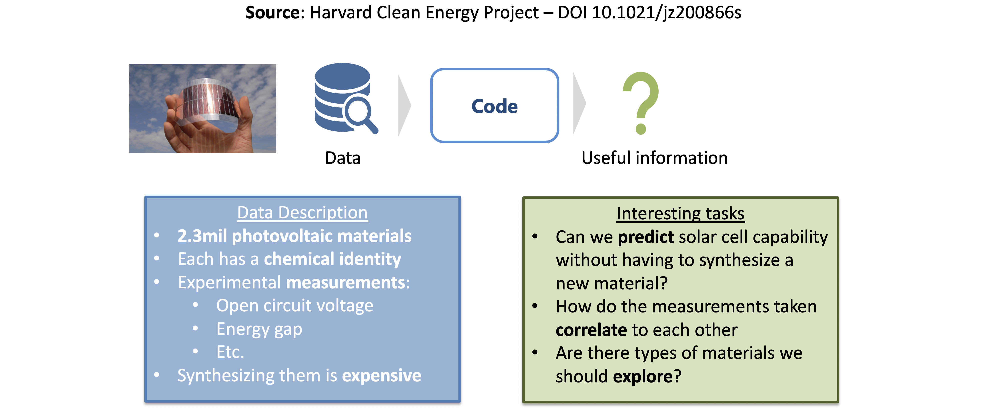

In [1]:
import pandas as pd
import numpy as np

# NEW! Matplotlib library, low level plot design
import matplotlib.pyplot as plt

In [2]:
# load the data by downloading it
df = pd.read_csv('http://faculty.washington.edu/dacb/HCEPDB_moldata.zip').sample(500, random_state=200)

In [3]:
df.describe()

,id,mass,pce,voc,jsc,e_homo_alpha,e_gap_alpha,e_lumo_alpha
count,5.000000e+02,500.000000,500.000000,500.000000,500.000000,500.000000,500.000000,500.000000
mean,1.356916e+06,419.245046,4.196245,0.559659,124.861324,-5.177109,1.859208,-3.317901
std,8.561752e+05,60.387252,2.600110,0.293260,66.402353,0.297923,0.395040,0.394108
min,9.620000e+02,219.415100,0.000000,0.000000,0.000000,-6.473389,0.953879,-4.161490
25%,6.479695e+05,383.155900,2.253676,0.360773,76.713722,-5.360915,1.561122,-3.642124
50%,1.251205e+06,421.474850,3.704855,0.562222,116.897966,-5.172307,1.837383,-3.321013
75%,2.051238e+06,463.374500,6.063341,0.749611,171.426359,-4.977756,2.114717,-3.035604
max,3.100289e+06,591.594900,10.976759,1.873389,330.146932,-4.301993,3.122995,-2.101135


In [4]:
df.columns

Index(['id', 'SMILES_str', 'stoich_str', 'mass', 'pce', 'voc', 'jsc',
       'e_homo_alpha', 'e_gap_alpha', 'e_lumo_alpha', 'tmp_smiles_str'],
      dtype='object')

<center>
    <font size=5>
        We have two nominal data fields (SMILES and stoichiometry) and a bunch of quantitative experimental measurements

### A. Matplotlib: The most simple

<font size=4>

This __simplest__ interaction we can make with matplotlib is the `pyplot.plot` function. It expects `x` and `y` data:

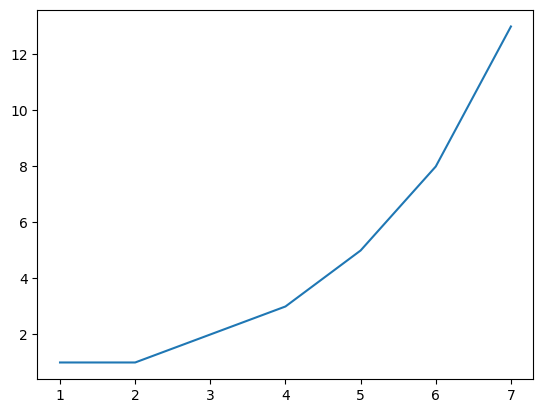

In [5]:
x = [1,2,3,4,5,6,7]
y = [1,1,2,3,5,8,13]
plt.plot(x,y)


<font size=4>It created an x an y axis, assigned it the correct quantitative values, and chose some encodings for us:</font>
- it uses a 1d line encoding
- the line is blue, and has width 1
- etc.


<font size=4>We can pass x and y data as __other data structures__, for example a pandas series:

In [6]:
type(df['jsc'])

pandas.core.series.Series

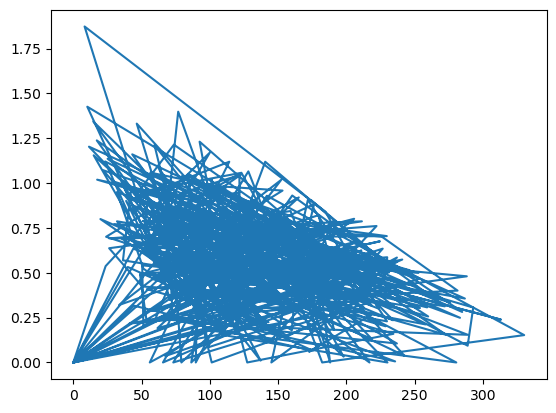

In [7]:
plt.plot(df['jsc'], df['voc'])

<font size=4>We can see that those default encodings __are not a good choice for this data__. We can use different plot types to change the encoding - the `scatter` function will use 0D points instead of 1D lines.

### B. Basic plot attributes

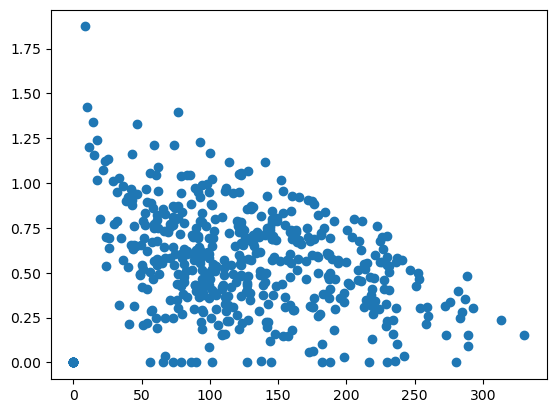

In [8]:
plt.scatter(df['jsc'], df['voc'])

<font size=4>This is much more interpretable, but still lacking. What data are we actually looking at? We can ask matplotlib to __give our plot some labels__.

Text(0.5, 1.0, 'VOC vs Jsc')

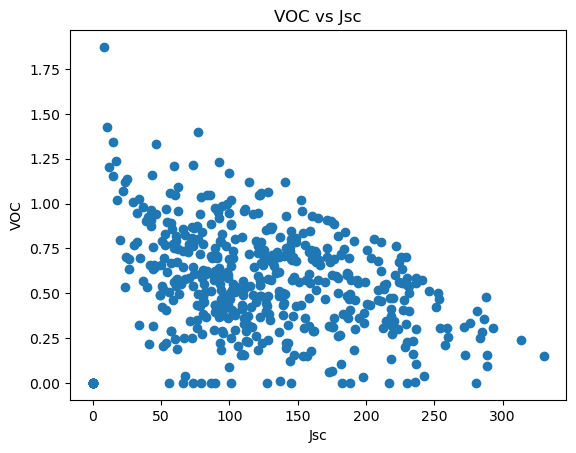

In [9]:
plt.scatter(df['jsc'], df['voc'])
plt.xlabel('Jsc')
plt.ylabel('VOC')
plt.title('VOC vs Jsc')


<font size=4>We have a somewhat __useful plot__! We can see that there is __something of a relationship__ between the two variables, and there is more frequently data around the (75.0, 0.7) area.

<font size=4>We were able to to change the encoding type to 0D points with scatter, but we can see that other parts of the encoding was still chosen for us, for example color, marker style and size. Let's change the color!

Text(0.5, 1.0, 'VOC vs Jsc')

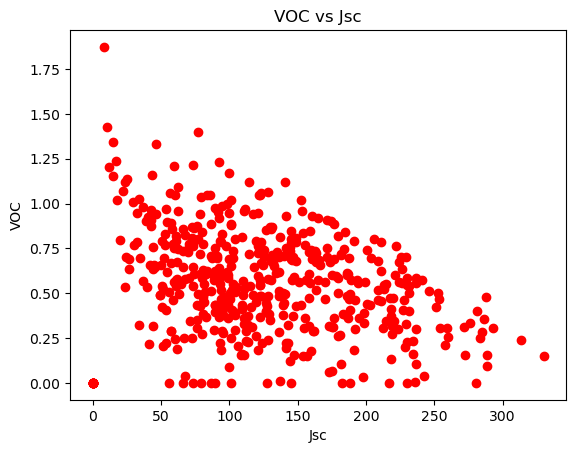

In [10]:
plt.scatter(df['jsc'], df['voc'], color='red')
plt.xlabel('Jsc')
plt.ylabel('VOC')
plt.title('VOC vs Jsc')

### C. Exercise 1:

<font size=4>Create a new plot of the relationship between `Jsc` and `PCE` using square markers of size 2. Try looking up the documentation for how to change markers and marker sizes!

><span style='color:red'>remove for lecture</span>

Text(0.5, 1.0, 'VOC vs PCE')

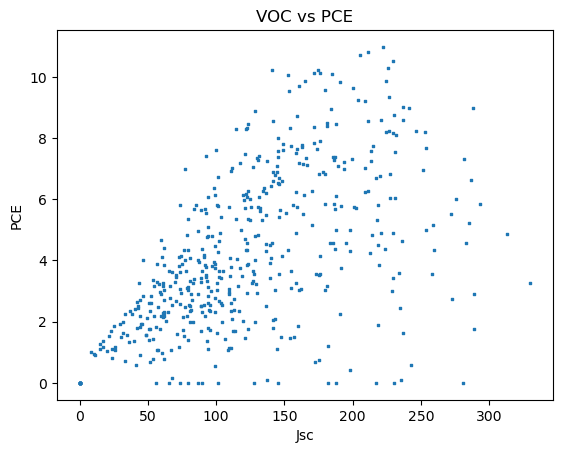

In [11]:
plt.scatter(df['jsc'], df['pce'], marker='s', s=2)
plt.xlabel('Jsc')
plt.ylabel('PCE')
plt.title('VOC vs PCE')

### D. Subplots

<font size=4>If we want __any more than a quick and basic plot__ like above, we use the `fig, ax` notation. Let's talk about three different entities in `matplotlib`:
1. The `figure` - this object is the set of pixels we will draw on, think of it like an artist's canvas.
2. The `axes` (with an __e__) - Each figure has one or more axes. Think of this like the set of information the artist has in their brain in order to create a painting. Multiple axes means multiple paintings on the canvas
3. The `axis` (with an __i__) - This is the axis you are likely familiar with, like the `x` and `y` axis. This is the line that you can use to determine what value of x or y the data has.

<font size=4>The `fig, ax` notation:

fig: <class 'matplotlib.figure.Figure'>, ax: <class 'matplotlib.axes._subplots.AxesSubplot'>


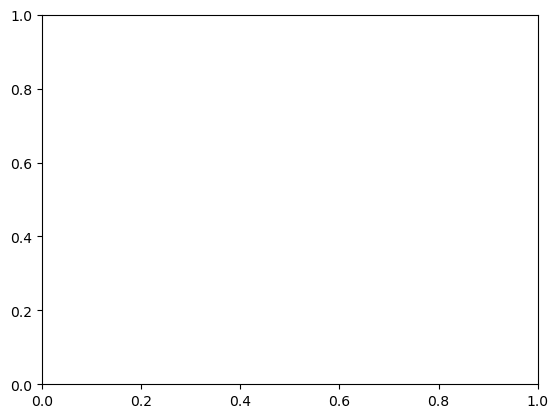

In [12]:
fig, ax = plt.subplots()
print(f"fig: {type(fig)}, ax: {type(ax)}")

<font size=4>The `fig` variable is the figure. The `ax` variable is the axes. We can procede similarly to give our plot data:

Text(0.5, 1.0, 'VOC vs Jsc')

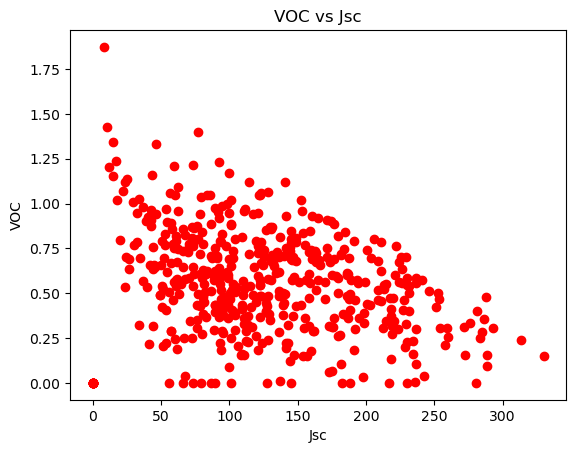

In [13]:
fig, ax = plt.subplots()
ax.scatter(df['jsc'], df['voc'], color='red')
ax.set_xlabel('Jsc')
ax.set_ylabel('VOC')
ax.set_title('VOC vs Jsc')

<font size=4>Notice how we __set__ the attributes of the `axes` object. This gives us access to more flexibility such as having multiple encodings on the same plot.

<font size=4>Here I plot __materials with small mass as a different color__ than materials with large mass.

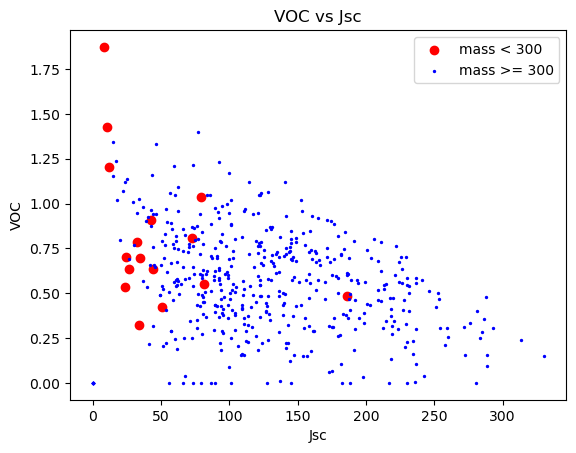

In [14]:
small_mass = df[df['mass'] < 300] # data has mass less than 300
large_mass = df[df['mass'] >= 300] # data has mass greater than 300

fig, ax = plt.subplots()

# plot the different data groups as different colors
ax.scatter(small_mass['jsc'], small_mass['voc'], color='red', label='mass < 300')
ax.scatter(large_mass['jsc'], large_mass['voc'], color='blue', s=2, label='mass >= 300')

ax.set_xlabel('Jsc')
ax.set_ylabel('VOC')
ax.set_title('VOC vs Jsc')
plt.legend() # add a legend

<font size=4>From this small data sample it seems like small mass materials have a steaper VOC/Jsc relationship, and that they do not have high Jsc values.

<font size=4>__Don't worry about the specific takeaways about the data__, this is more about how we can __use plots to craft our message__. I hope you can see how cool this is! We can encode our data in many different ways in order to __compare and contrast different groups, gleen relationships, etc__.

<font size=4> You can also use subplots to have __multiple plots in one figure__, for example, to explore the relationship of one variable with two others:

[<AxesSubplot: > <AxesSubplot: >]


Text(0, 0.5, 'Mass')

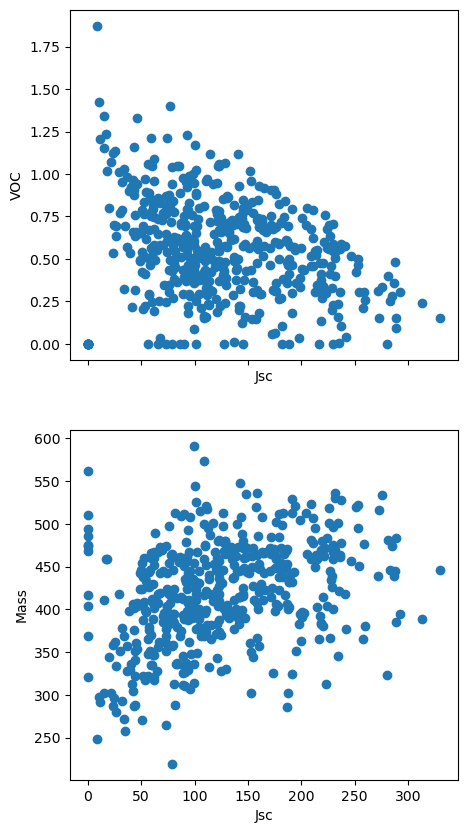

In [15]:
fig, axes = plt.subplots(2,1, figsize=(5,10), sharex=True)

print(axes) # axes is now an array of axes objects instead of just one

# first plot
axes[0].scatter(df['jsc'], df['voc'])
axes[0].set_xlabel('Jsc')
axes[0].set_ylabel('VOC')

# second plot
axes[1].scatter(df['jsc'], df['mass'])
axes[1].set_xlabel('Jsc')
axes[1].set_ylabel('Mass')

<font size=5><center>
    We could probably draw similar conclusions from this plot as the one we created with different color encodings above... so with all these encodings: color, size, shape, orientation, etc. __how do we chose__?
    
***

## 3. Expressiveness and Effectiveness at a glance


### A. EE Balance

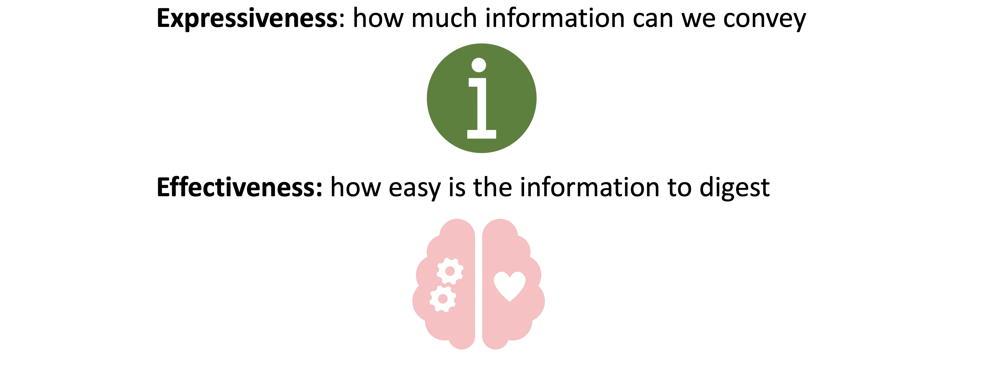
### A. EE Balance

<font size=5><center>
    A visual communication may have __lots of information, but inneffectively communicates__ it (think the table of data). On the other hand, we can create an __easy to interpret, visually appealing image but it is too simple__ to provide the message we want. This is a balance.
    
***

<font size=5><center>
    There has been lots of work studying how be extract the best balance, for example the [Tableau 20](https://www.tableau.com/blog/colors-upgrade-tableau-10-56782) is a set of colors that has a good balance of contrasts and hues for differentiating even with colorblindness:

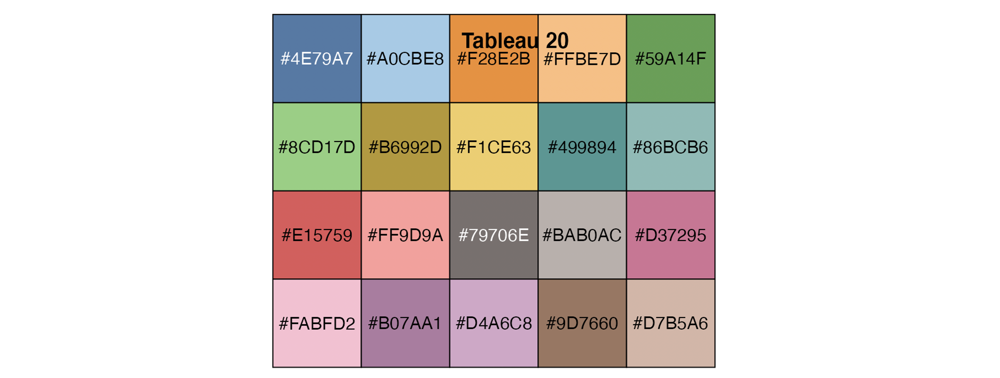

***

<font size=5><center>
   Or a comparison of effectiveness of different encoding types:

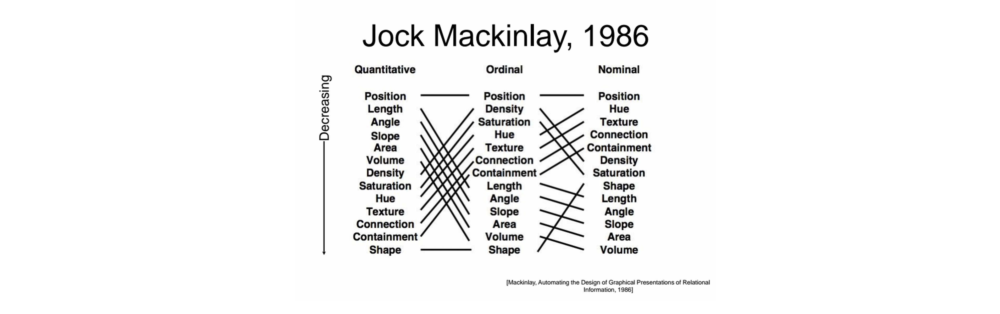

<font size=5><center>
   __This is a vibrant and rigorous field of research__, for more, please consider taking a class such as CSE512.

### B. Poll: rate some plots

<font size=5><center>1. Is the right plot less, the same, or more __expressive__?  
2. Is the the right plot less, the same, or more __effective__?

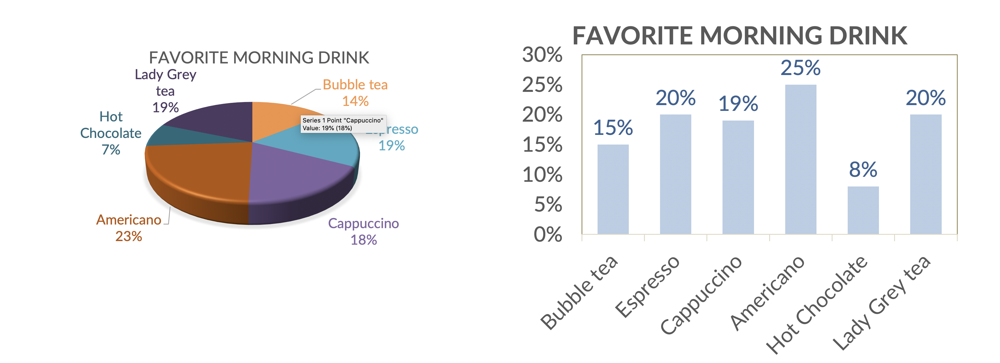

<font size=5><center>3. Rate the __expressiveness__?  
4. Rate the __effectiveness__?

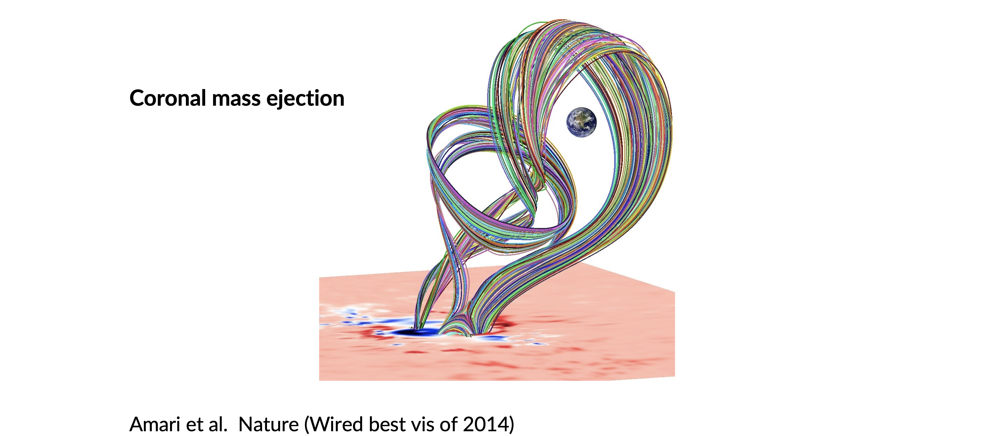

<font size=5><center>5. Rate the __expressiveness__?  
6. Rate the __effectiveness__?

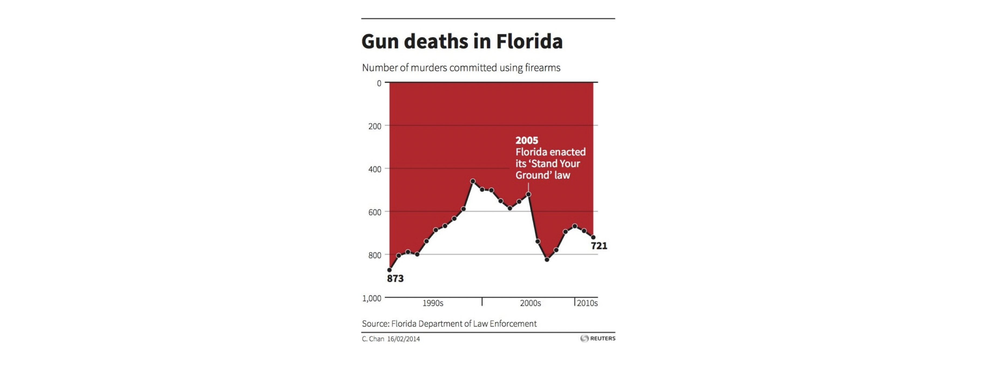

<font size=5><center>
   _Word of caution_: Visualizations can be used to both __lie__ and __decieve__. Do not make plot choices in order to communicate a message that the data does not atually support.

## 4. Back to the Python
<font size=4> `matplotlib` plots can be made directly from `pandas dataframes`


<AxesSubplot: >

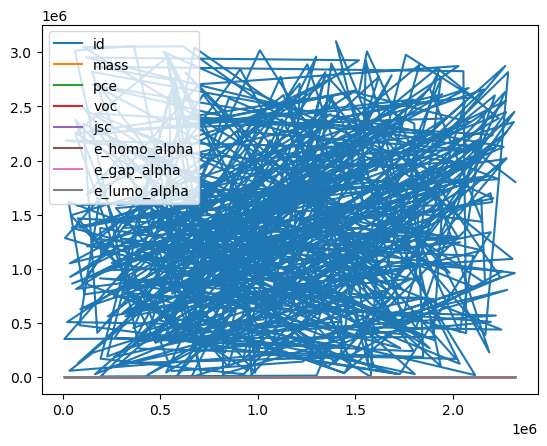

In [16]:
df.plot()

<font size=4>Be default, pandas __automatically created a line plot of each quantititative field in the data__ and put it on the same axis. We can see that there is a huge amount of information here but it is not effective. Let's specify what fields we want to plot, and change the plot type

<AxesSubplot: xlabel='jsc', ylabel='voc'>

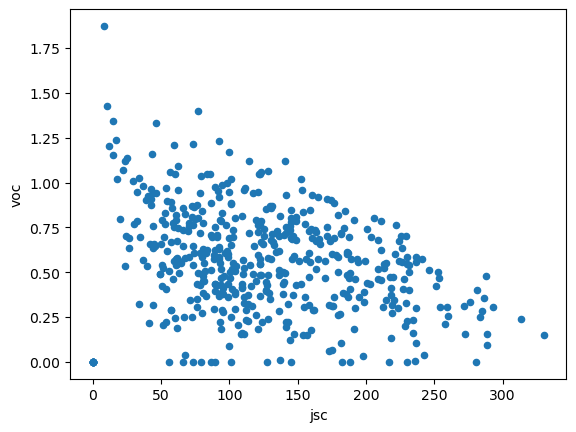

In [17]:
df.plot(kind='scatter', x='jsc', y='voc')

<font size=4>We can see that it produced our axis labels for us based on the column names. __All of the usual arguments apply__, eg we can change the color.

<AxesSubplot: xlabel='jsc', ylabel='voc'>

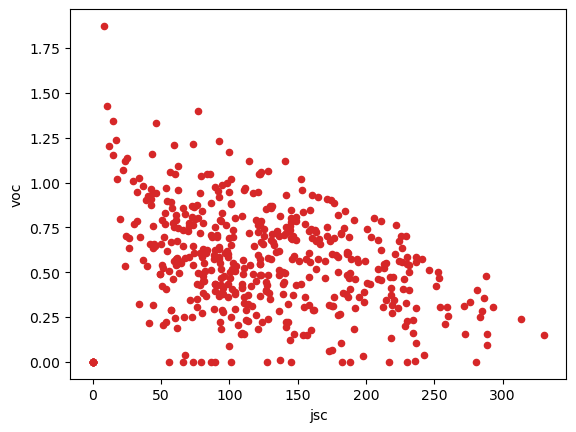

In [18]:
df.plot(kind='scatter', x='jsc', y='voc', color='tab:red')

<font size=4>These `pandas` functions can be told what `axes` to plot on:

Text(0.5, 1.0, 'Made a plot directly from pandas dataframe')

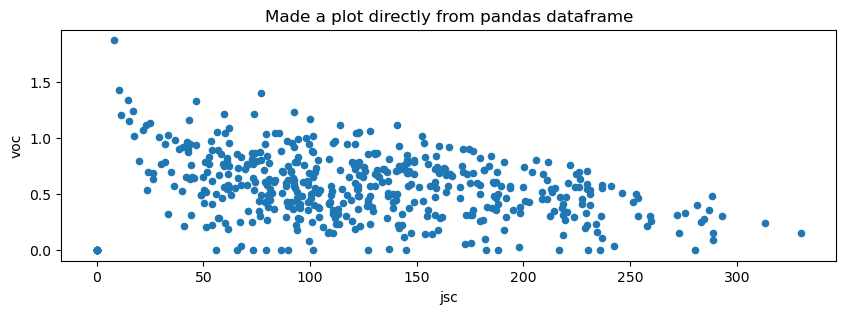

In [19]:
fig, ax = plt.subplots(figsize=(10,3))
df.plot(kind='scatter', x='jsc', y='voc', ax=ax)
ax.set_title("Made a plot directly from pandas dataframe")

### B. Plot type Zoo

<font size=4>Let's go through some common plot types, what they describe, and when to use them. Note that for every `pandas` function, there is a base `matplotlib one`. __This list is non exhaustive__ but 

#### Line plot
<font size=3>You've seen this. Shows the __change in a measurement that was taken ordinally__. Use when you have a series of data that was taken moving forward in time, along the length of something, etc. 

__It does not make sense for this data__


<AxesSubplot: xlabel='jsc'>

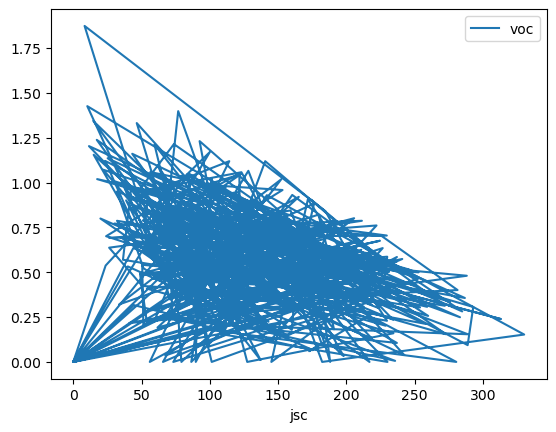

In [20]:
df.plot(kind='line', x='jsc', y='voc')

#### Scatter plot
<font size=3>You've seen this. Shows the __individual measurements of two variables__. Use when you have data that you want to investigate for relationships, outliers, etc. Not very effective when density of data is too high and data overlaps.


<AxesSubplot: xlabel='jsc', ylabel='voc'>

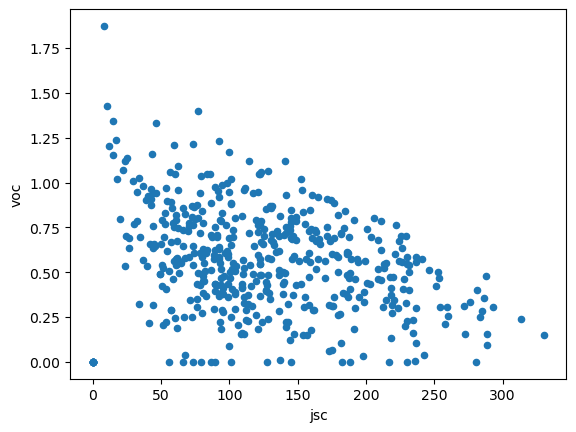

In [21]:
df.plot(kind='scatter', x='jsc', y='voc')

#### Bar plot
<font size=3>Shows the __the effect of an ordinal or nominal variable__. Use when you have a measurement vs a nominal or you have multiple measurements that you want to __aggregate__ over data.
    
<font size=3>_NOTE_: You saw data aggregation with pandas in SEDS. In data vis, when we aggregate, we generally do so in order to increase _effectiveness_ at the cost of _expressiveness_.


In [22]:
df['has silicon'] = df['SMILES_str'].apply(lambda s: 'Si' in s) # add a column that indicates if the material is silicon based

In [23]:
df['has silicon']

1090677    False
813514     False
103256      True
1652501    False
1064161    False
           ...  
1570658     True
1830444     True
303664     False
2065923    False
2321688     True
Name: has silicon, Length: 500, dtype: bool

/var/folders/9j/1f7mt18d2pqcwws6hwdx7_kr0000gn/T/ipykernel_78463/3235655880.py:1: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  df.groupby('has silicon').mean().reset_index().plot(kind='bar', x='has silicon', y='jsc')


<AxesSubplot: xlabel='has silicon'>

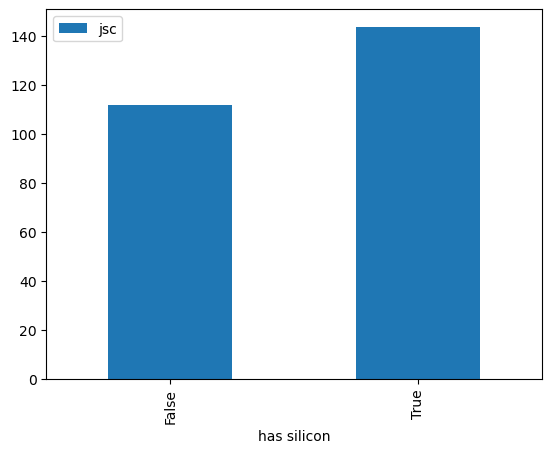

In [24]:
df.groupby('has silicon').mean().reset_index().plot(kind='bar', x='has silicon', y='jsc')

#### Histogram
<font size=3>A type of bar plot. __Shows the counts of data  discretized into small bins__. For example, if a measurement has min and max 0.0 to 10, a hist shows the counts of measurements that were between 0.0 and 1.0, then 1.0 and 2.0 etc. Use when you want to view an emirical distribution of your data


<AxesSubplot: ylabel='Frequency'>

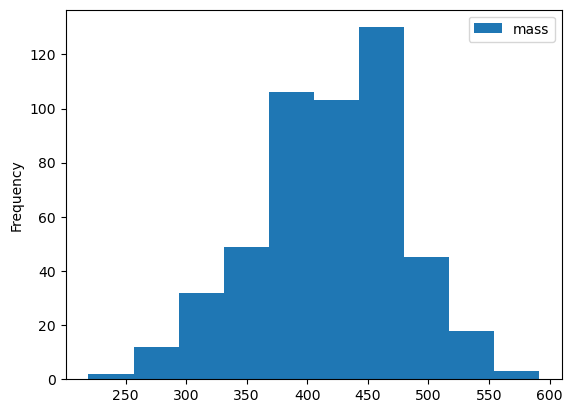

In [25]:
df.plot(kind='hist', y='mass')

#### Box and whisker plot
<font size=3>__Shows the quantiles of the data__. Use when you want to view the data's empirical distribution. Box plots have less expressiveness than histograms because you can no longer see counts in many bins, just quantiles, but it allows you to more easily compare different variables or view the effect of nominal variables on the measurement.


<AxesSubplot: >

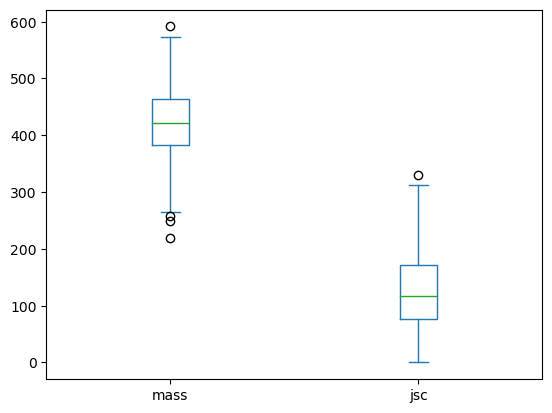

In [26]:
df.plot(kind='box', x='has silicon', y=['mass', 'jsc'])

#### Density estimate
<font size=3>__Shows estimated frequency of data along its range__. This is just like a histogram, except it uses something called a "kernel" to estimate a continuous distribution from the empirical counts. Use when trying to view an empirical distribution.


<AxesSubplot: ylabel='Density'>

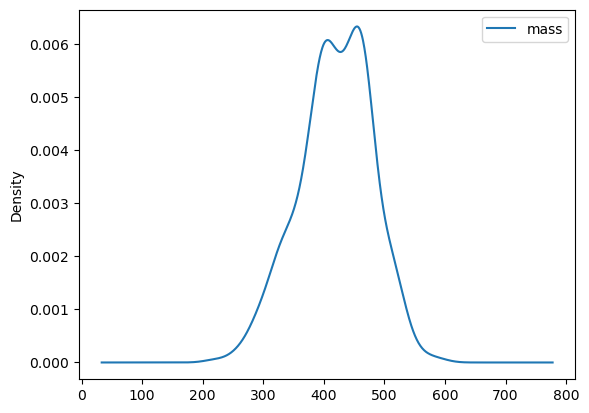

In [27]:
df.plot(kind='kde', y='mass')

<font size=3>Compared to the bar encoding of a histogram, it can be easier to view the distribution of multiple columns with KDE

<AxesSubplot: ylabel='Density'>

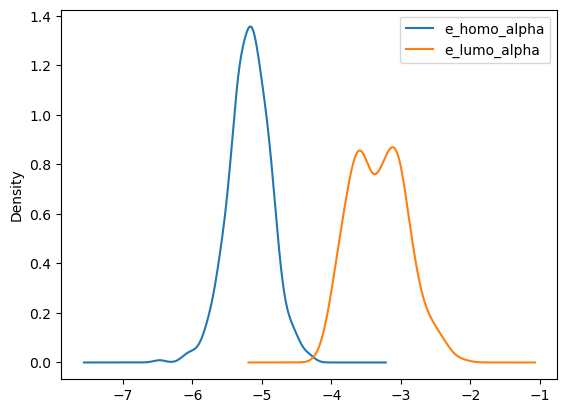

In [28]:
df.plot(kind='kde', y=['e_homo_alpha', 'e_lumo_alpha'])

#### Pie
<font size=3>__Shows the relative sizes of parts of a whole__. Use when data comparing frequancy of nominal variables or a set of measurements sum to 1.0.

<AxesSubplot: ylabel='id'>

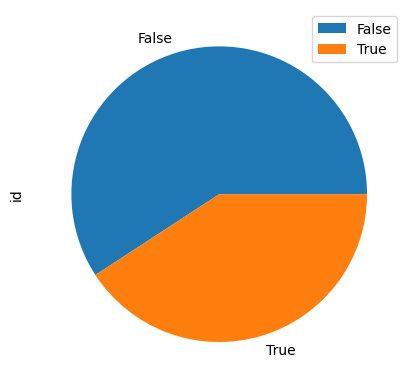

In [29]:
df.groupby('has silicon').count().plot(kind='pie', y='id')

#### Summary of basic plots


| Type      | X | Y | When |
| ----------- | ---------------- | ---------------- |  -------------------------------- |
| Line        | O or Q in series | Q                | Y is measured in a series         |
| Scatter     | Q                | Q                | You want to see individual points and data is not too dense         |
| Bar         | O or N           | Q                | You have a nominal or ordinal X         |
| Hist        | Q                | None             | You want to view the empirical counts of X        |
| Box         | Q                | None             | You want to view the empirical distribution of X, potentially multiple X, or the effect of a nominal variable on |
| Density     | Q                | None             | You want to view the empirical distribution of X estimated as a continuous value |

<center>Key: O = ordinal, Q = Quantitative, N = Nominal</center>

### C. Exercise: create a visual communication to explore a question

<font size=3>Utilize methods we have seen such as aggregation, the different plot types, color encoding, etc. to create a commmunication exploring the following:
    
<font size=4><center>__How is the difference in HOMO and LUMO energy gap effected by material molar mass?__

><span style='color:red'>remove for lecture</span>

In [30]:
# let's create a new column
df['LUMO - HOMO'] = df['e_lumo_alpha'] - df['e_homo_alpha']

<font size=4>High expressiveness and low effectiveness

<AxesSubplot: xlabel='mass', ylabel='LUMO - HOMO'>

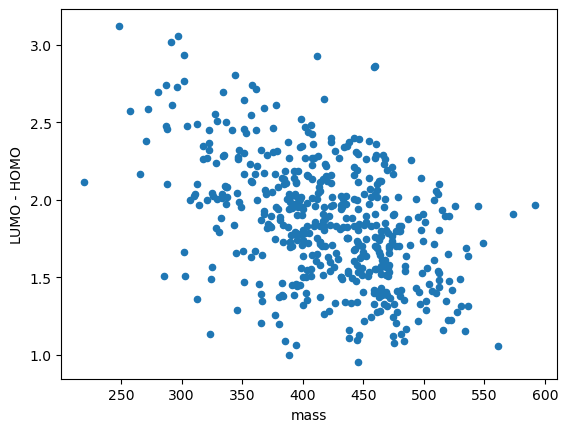

In [31]:
df.plot(kind='scatter', x='mass', y='LUMO - HOMO')

<font size=3>There is a clearly a negative relationship - larger structures tend to have lower gaps, but the scatter makes it hard to see more than the general trend.

<font size=4>Low expressiveness and high effectiveness

In [32]:
df['mass bin'] = pd.cut(df['mass'], 5)

/var/folders/9j/1f7mt18d2pqcwws6hwdx7_kr0000gn/T/ipykernel_78463/3776198270.py:1: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  df.groupby('mass bin').mean().reset_index().plot(kind='bar', x='mass bin', y='LUMO - HOMO')


<AxesSubplot: xlabel='mass bin'>

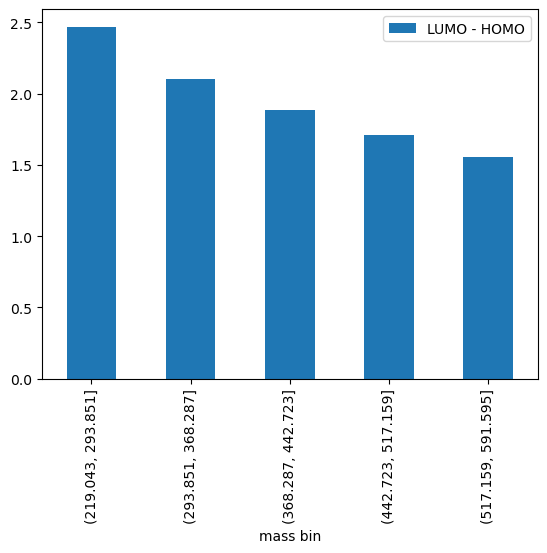

In [33]:
df.groupby('mass bin').mean().reset_index().plot(kind='bar', x='mass bin', y='LUMO - HOMO')

<font size=3>We can see that the trend on on average in this plot confirms the above, but now we have no expressiveness of the data distribution

<font size=4>Medium expressiveness and high effectiveness

In [34]:
import matplotlib

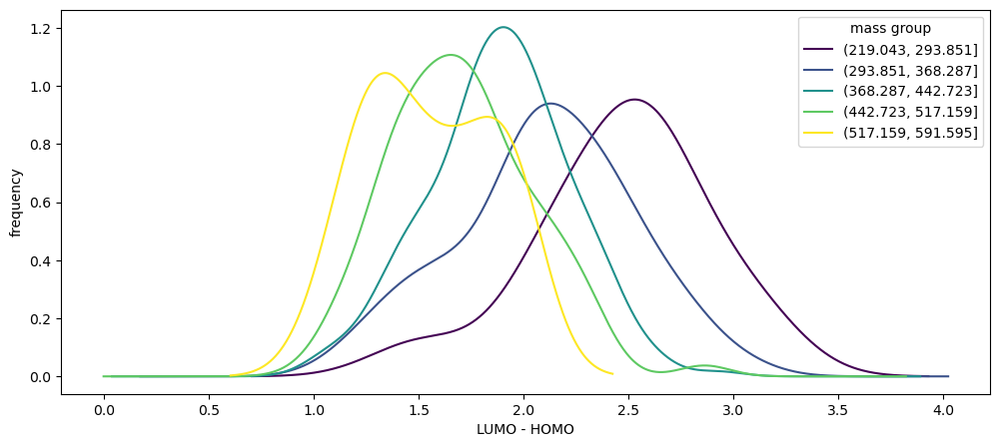

In [35]:
groups = df.groupby('mass bin')

fig, ax = plt.subplots(figsize=(12,5))

colormap = matplotlib.colormaps['viridis']
colors = np.linspace(0, 1, len(groups))

for i, (group_name, df_) in enumerate(groups):
    df_.plot(kind='kde', y='LUMO - HOMO', ax=ax, label=group_name, c=colormap(colors[i]))

ax.set_xlabel('LUMO - HOMO')
ax.set_ylabel('frequency')
plt.legend(title='mass group')

<font size=3>As before we can see there is a negative relationship between the mean LUMO-HOMO gap and mass, but now we can also see that the distribution changes. The distributions get tighter as mass gets larger and it also seems like the relationship is asymptotic - raising the mass a lot more may not change the gap much

<font size=4><center>__Do not feel like you had to achieve something like this yet__, I had to stretch passed what we have seen to make it happen. But do you notice how much __harder__ this was than the other plots to create??

### D. Seaborn

<font size=4>Seaborn is a library for plot __built over matplotlib__ that allows you to more quickly create useful but more complex plots. __Everything you can do in seaborn you can do it matplotlib__, it just takes much more code.

In [36]:
import seaborn as sns

#### Faster aggregation, color, and style encodings for basic plot types

<AxesSubplot: xlabel='LUMO - HOMO', ylabel='Density'>

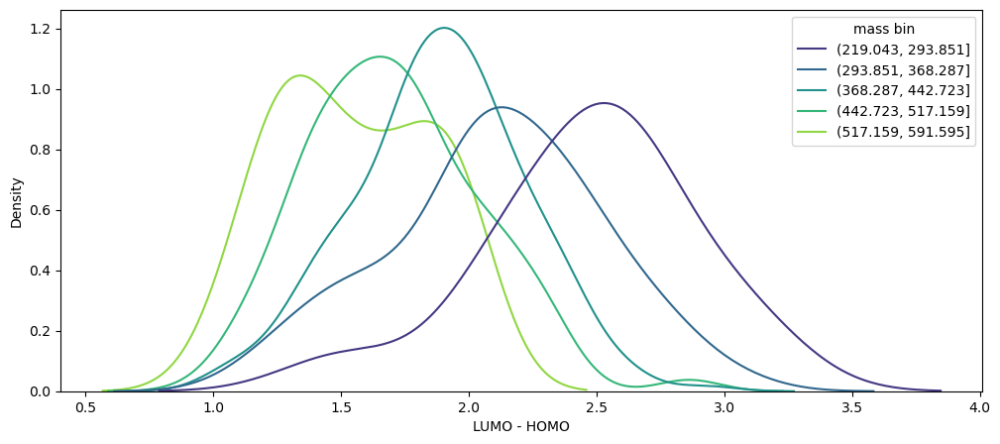

In [50]:
fig, ax = plt.subplots(figsize=(12,5))
sns.kdeplot(data=df, x='LUMO - HOMO', hue='mass bin', common_norm=False, palette='viridis')

<AxesSubplot: xlabel='mass bin', ylabel='LUMO - HOMO'>

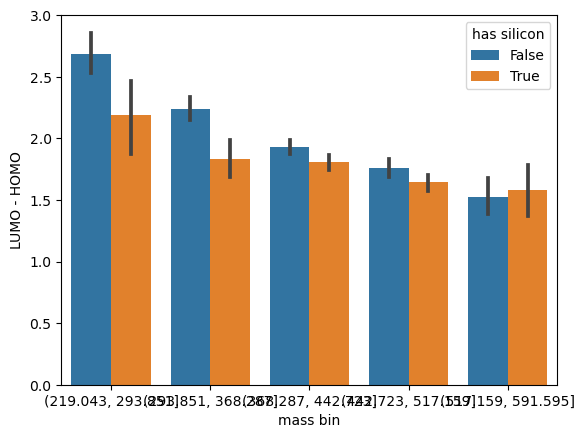

In [46]:
fig, ax = plt.subplots()
sns.barplot(data=df, x='mass bin', y='LUMO - HOMO', hue='has silicon')

#### Fast stylization

In [63]:
sns.set_style('whitegrid') # colors grids, etc
sns.set_context('talk') # font and line sizes

#### More complex plot type: heatmap
<font size=3>__Shows the value of a quantititative measure as color in 2D discrete bins__. Use if 2/3 variables are ordinal, or you want to aggregate over 2 quantititative measures. A very common use of a heatmap is as a 2D histogram, where the quantititative measure what we see as colors are histogram counts. Another common use is a correlation plot, below. _More on correlation next few lectures!_

/var/folders/9j/1f7mt18d2pqcwws6hwdx7_kr0000gn/T/ipykernel_78463/809566673.py:2: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(data=df.corr())


<AxesSubplot: >

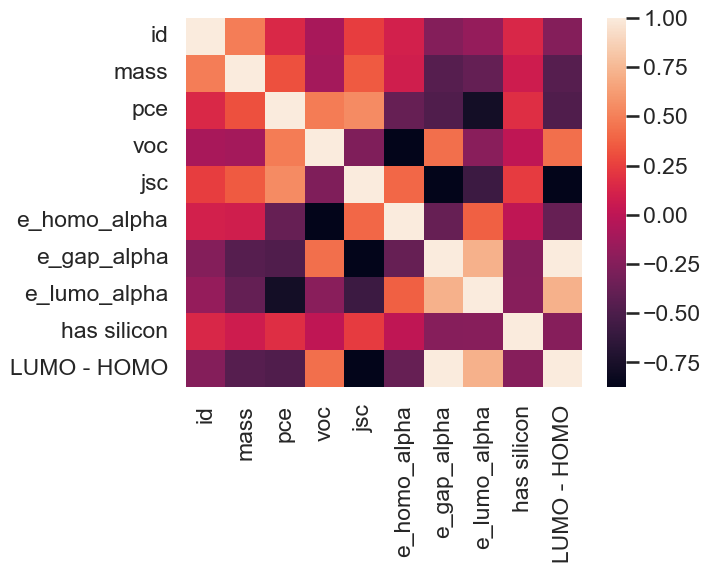

In [64]:
fig, ax = plt.subplots()
sns.heatmap(data=df.corr())

#### More complex plot type: 2D KDE
<font size=3>__Shows estimated frequency of data along its range for 2 dimensions__. Same as 1D kde except you can view joint distribution.

<AxesSubplot: xlabel='jsc', ylabel='voc'>

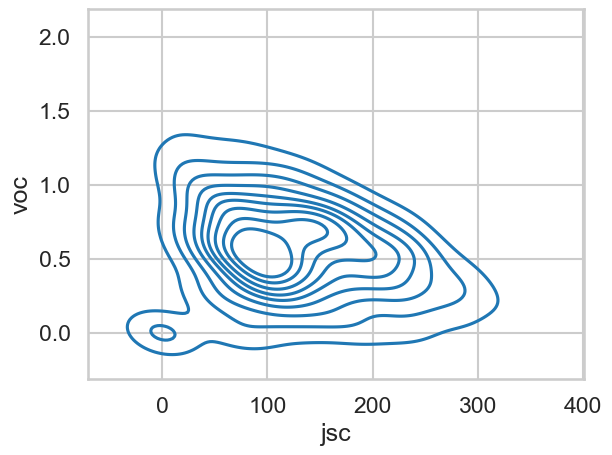

In [65]:
fig, ax = plt.subplots()
sns.kdeplot(data=df, x='jsc', y='voc', ax=ax)

#### More complex plot type: joint plot
<font size=3>__Shows data along its range for 2 dimensions, along with its independant distribution__. Anytime you would want a scatter or a 2D KDE, this is better!

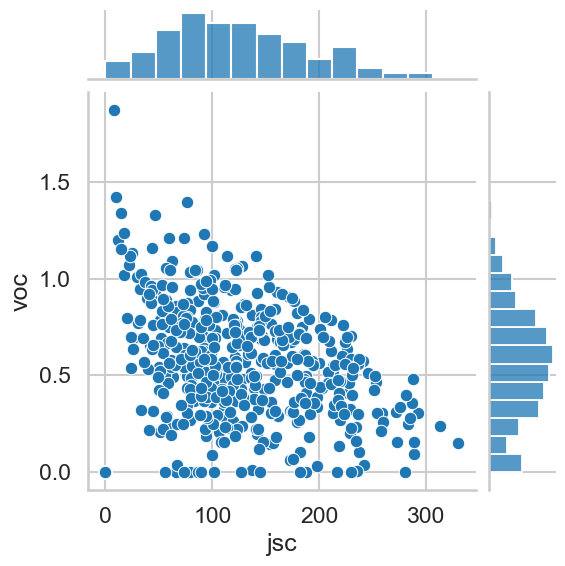

In [66]:
sns.jointplot(data=df, x='jsc', y='voc')

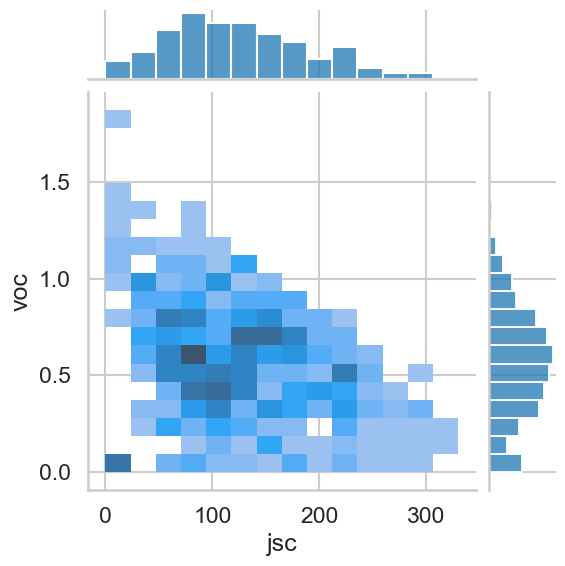

In [67]:
sns.jointplot(data=df, x='jsc', y='voc', kind='hist')

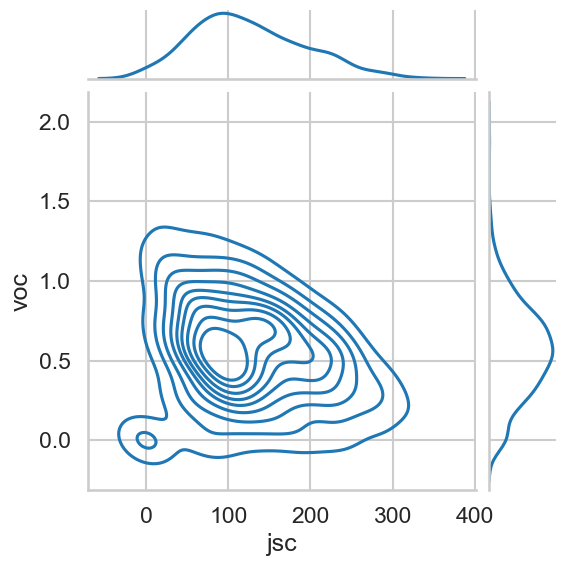

In [68]:
sns.jointplot(data=df, x='jsc', y='voc', kind='kde')

#### More complex plot type: violinploy
<font size=3>__Shows estimated distribution along its range, as well as quantiles__. Basically a combination of box and whisker and kde plot

<AxesSubplot: xlabel='LUMO - HOMO', ylabel='mass bin'>

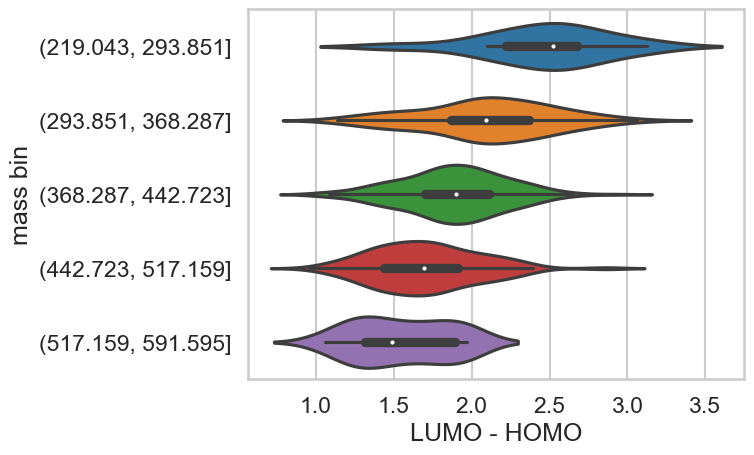

In [69]:
sns.violinplot(data=df, x='LUMO - HOMO', y='mass bin')

#### More complex plot type: pairplot
<font size=3>__Shows interaction of all fields of data__. Use if you don't have a specific question and you are just trying to get an idea of whats in the data.

<__array_function__ internals>:180: RuntimeWarning: Converting input from bool to <class 'numpy.uint8'> for compatibility.


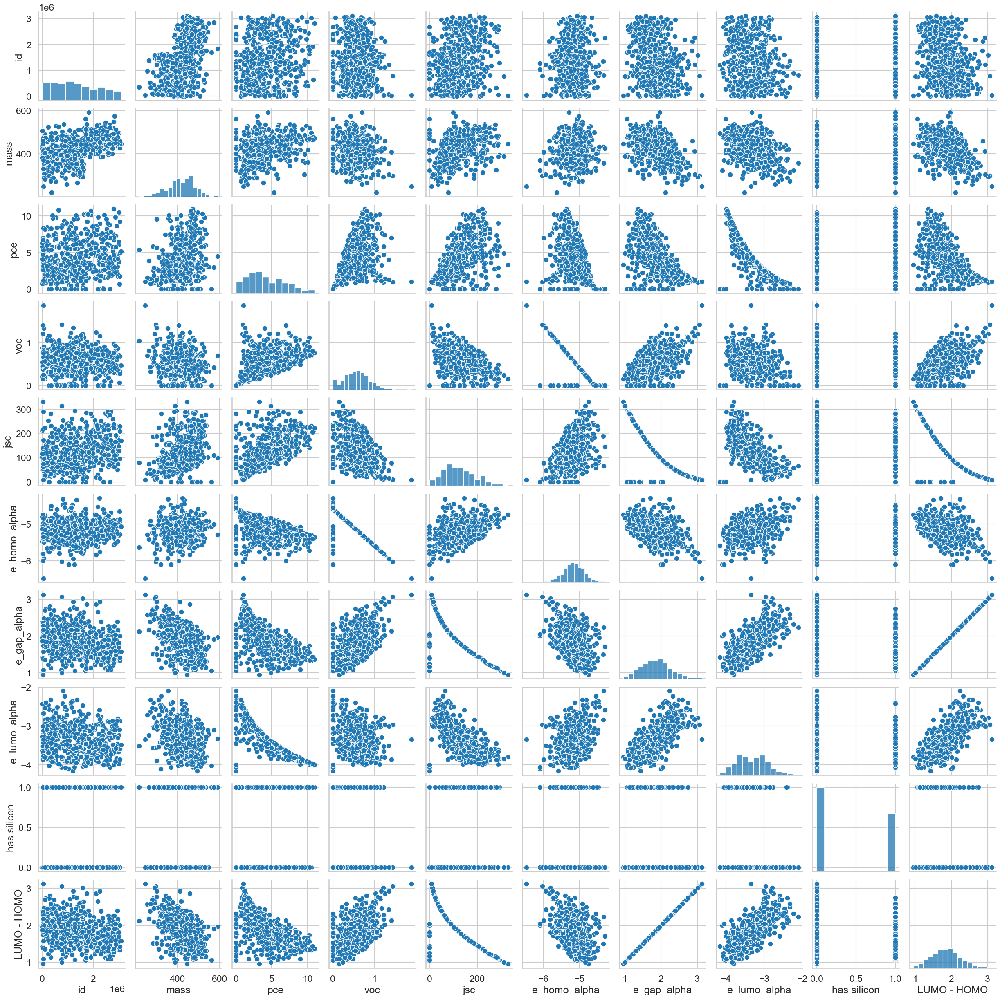

In [70]:
sns.pairplot(data=df, kind='scatter')

<font size=5><center>And this is just a few! Please see [seaborn documentation](https://seaborn.pydata.org/). 

## In summary...

- <font size=5>Making a plot is a balance of __expressiveness and effectiveness__
- <font size=5>There are __many different ways to encode data__ into position, color, shape, etc
- <font size=5>__Depending on the type of data__, different encodings are more effective
- <font size=5>We have seen how to make lots of plot types in python using `matplotlib`. `pandas.plot` and `seaborn` are built on top of this